### Import Dependencies & Library

In [ ]:
! pip install pytesseract
! apt-get install poppler-utils
! pip install pdf2image
! apt install tesseract-ocr
! apt install libtesseract-dev
! get install opencv
! pip install easyocr

  Created wheel for pytesseract: filename=pytesseract-0.3.8-py2.py3-none-any.whl size=14071 sha256=6bde6194d2303c597e435c7a3c5bcd4c9abe557a2784c70bc8583180c14a22eb
  Stored in directory: /root/.cache/pip/wheels/a4/89/b9/3f11250225d0f90e5454fcc30fd1b7208db226850715aa9ace
Successfully built pytesseract
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following NEW packages will be installed:
  poppler-utils
0 upgraded, 1 newly installed, 0 to remove and 40 not upgraded.
Need to get 154 kB of archives.
After this operation, 613 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic-updates/main amd64 poppler-utils amd64 0.62.0-2ubuntu2.12 [154 kB]
Fetched 154 kB in 1s (299 kB/s)
Selecting previously unselected package poppler-utils.
(Reading database ... 160837 files and directories currently installed.)
Preparing to unpack .../poppler-utils_0.62.0-2ubuntu2.12_amd64.deb ...
Unpacking poppler-utils (0.62.0-

In [ ]:
import pdf2image
from pdf2image import convert_from_path
import easyocr
import numpy as np
import PIL
from PIL import ImageDraw, Image, ImageFont
import spacy

from IPython.display import display, Image

import os
import tempfile
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2

import json

## Inisiasi OCR
Mendfinisikan bahasa dan font yang akan digunakan, yaitu bahasa indonesia

In [ ]:
# 'en' = English
# 'id' = Indonesia
reader = easyocr.Reader(['id'])
font = ImageFont.load_default()

CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.


## **Definisi Basic Function**
Function atau prosedur yang akan digunakan untuk beberapa bagian selanjutnya

In [ ]:
def plot_img(images, titles):
  fig, axs = plt.subplots(nrows = 1, ncols = len(images), figsize = (15, 15))
  for i, p in enumerate(images):
    axs[i].imshow(p, 'gray')
    axs[i].set_title(titles[i])
    #axs[i].axis('off')
  plt.show()

def draw_boxes(image, bounds, color='yellow', width=2):
    draw = ImageDraw.Draw(image)
    for bound in bounds:
        p0, p1, p2, p3 = bound[0]
        draw.line([*p0, *p1, *p2, *p3, *p0], fill=color, width=width)
        try:
          draw.text(p0, bound[1], font=font, fill='red')
        except:
          print(bound[1])
    return image


### Upload File PDF

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving data1.PDF to data1.PDF


### **Convert PDF**
Konversi File PDF menjadi beberapa images sesuai dengan jumlah halaman yang ada di PDF

In [ ]:
# path to read pdf
file_pdf = "data1.PDF"

# this section finish if the user only need the image pdf not the pages
# Store all the page
pdf_pages = convert_from_path(file_pdf, 500)

# the index counter store for each images
image_counter = 1 

# iterate all the pages stored in the pdf file
for page in pdf_pages:
  filename = "page_" + str(image_counter) + ".jpg"
  page.save(filename, 'JPEG')
  
  #Increment the counter to update filename
  image_counter = image_counter + 1

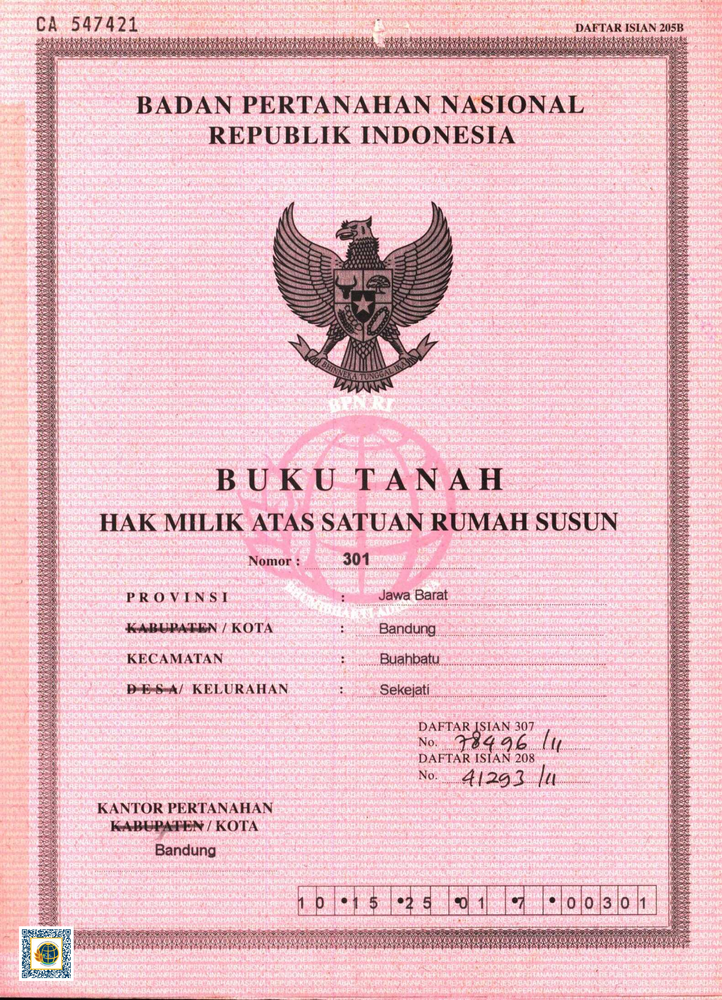

In [ ]:
#cek gambar
pdf_pages[0]

In [ ]:
## should using the image with the jpg format
## if using after converter result, will goes error

# pdf_img = cv2.imread(images_pdf[0])
# pdf_img = cv2.imread(pdf_pages[0])
pdf_img = cv2.imread('page_1.jpg')

test_img = PIL.Image.fromarray(pdf_img)

### **Preprocessing Phase**
pada tahap preprocessing images, metode yang digunakan adalah thresholding,
gunanya untuk membuat background pada original image tidak ikut terdeteksi OCR dan menjadi noise

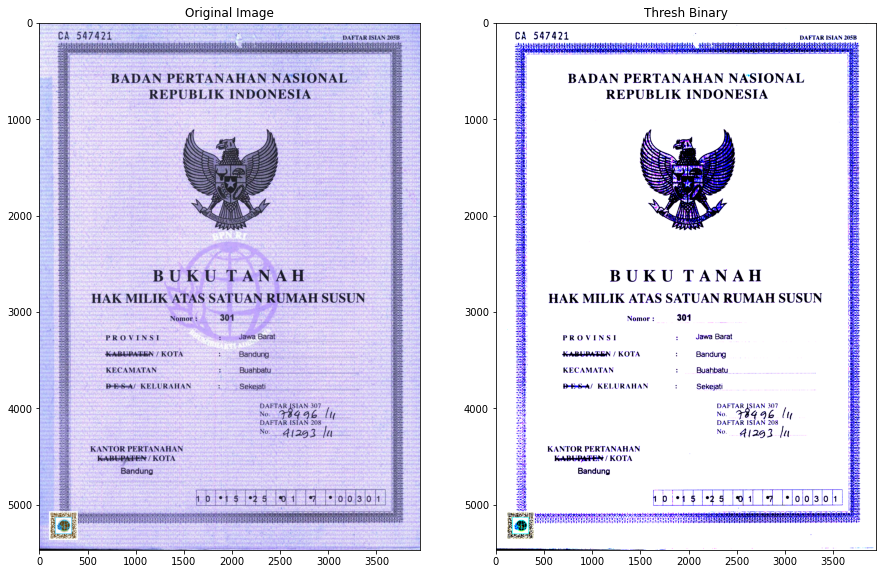

In [ ]:
### Input Threshold Preprocess  
img = pdf_img
img = cv2.medianBlur(img, 5)

### Input Threshold Preprocess  
ret, th1 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)

# Plotting the images
result_img = [img, th1]
titles = ['Original Image', 'Thresh Binary']
plot_img(result_img, titles)

### **OCR Phase**
tahap penggunaan OCR, hasil dari OCR dapat dilihat dengan box-box pada tulisan yang ada pada images

In [ ]:
bounds = reader.readtext(np.array(th1), min_size=0, slope_ths=0.2, 
                         ycenter_ths=0.7, height_ths=0.6, width_ths=0.8,
                         decoder='beamsearch', beamWidth=10)
bounds

In [ ]:
# def draw_boxes(image, bounds, color='green', width=2):
#   gambar = PIL.Image.fromarray(image)
#   draw = ImageDraw.Draw(gambar)
#   for bound in bounds:
#     p0, p1, p2, p3 = bound[0] #every angle of the bounding box
#     draw.line([*p0, *p1, *p2, *p3, *p0], fill=color, width=width)
#   return gambar

# # th1_copy = cv2.cvtColor(th1, cv2.COLOR_GR)
# draw_boxes(th1.copy(), bounds, color='red')
th1_copy = PIL.Image.fromarray(th1)

# draw_boxes(test_img.copy(), bounds, color='red')
draw_boxes(th1_copy, bounds, color='red')

### **OCR Result**
Hasil dari OCR akan di eksport menjadi text file untuk di cek, langkah selanutnya adalah memasukkan hasil ocr langsung kedalam JSON

In [ ]:
bounds[1][1]

[[3143, 117], [3749, 117], [3749, 189], [3143, 189]]

In [ ]:
bounds[1][2]

In [ ]:
#list index nol menunjukan isi value contoh "Hak Milik"
#list index pertama menunjukan isi value contoh "Hak Milik"
print(bounds[6][1])
#list index yang kedua menunjukan akurasi dari pengambilan ocr
print(bounds[6][2])

HAK MILIK ATAS SATUAN RUMAH SUSUN
0.7174202651286673


In [ ]:
# Concate the bounding box into a single text


text=''
for i in range(len(bounds)):
  text = text + bounds[i][1] + '\n'

print(text)

Ca 547421
DAFTAR ISIAN 205B
BADAN PERTANAHAN NASIONAL
REPUBLIK INDONESIA
1a
BU KU TANA H
HAK MILIK ATAS SATUAN RUMAH SUSUN
Nomor
301
PR 0 VI N S [
Jawa Barat
KARUAATEN
KOTA
Bandung
KECAMATAN
Buahbatu
P-FA/ KELURAHAN
Sekejati
DAFTAR ISIAN 307
No.
8496 (
DAFTAR ISIAN 208
No.
41293 /ı
KANTOR PERTANAHAN
KABUPAFEN / KOTA
Bandung
p121 5
2 5
3



### **Importing to JSON Dictionary**
Hasil dari OCR akan dipindahkan kedalam JSON dengan versi manual terlebih dahulu

In [ ]:
result_json = {
    "id_dokumen": bounds[0][1],
    "nomer_daftar_isian": bounds[1][1],
    "badan_pemilik": bounds[2][1],
    "negara": bounds[3][1],
    "kategori_dokumen": bounds[5][1],
    "judul": bounds[6][1],      
    "nomer_isi": bounds[8][1],
    "provinsi": bounds[10][1],
    "kabupaten_or_kota": bounds[13][1],
    "kecamatan": bounds[15][1],
    "desa_or_kelurahan": bounds[17][1],
    "daftar_isian_307": None, 
    "daftar_isian_208": None,
    "cabang_kantor_pertanahan": bounds[26][1]
}

### daftar isian 307 dan 208 berupa handsign, perlu dikonfirmasi terlebih dahulu apakah harus diambil atau tidak

In [ ]:
result_json

{'badan_pemilik': 'BADAN PERTANAHAN NASIONAL',
 'cabang_kantor_pertanahan': 'Bandung',
 'daftar_isian_208': None,
 'daftar_isian_307': None,
 'desa_or_kelurahan': 'Sekejati',
 'id_dokumen': 'Ca 547421',
 'judul': 'HAK MILIK ATAS SATUAN RUMAH SUSUN',
 'kabupaten_or_kota': 'Bandung',
 'kategori_dokumen': 'BU KU TANA H',
 'kecamatan': 'Buahbatu',
 'negara': 'REPUBLIK INDONESIA',
 'nomer_daftar_isian': 'DAFTAR ISIAN 205B',
 'nomer_isi': '301',
 'provinsi': 'Jawa Barat'}